# Test Inference Pipeline

In [ ]:
import sys

sys.path.append("/Users/mathisnicoli/Desktop/Projets/faraway/faraway")
from PIL import Image
from inference_pipeline import InferencePipeline
import cv2
import numpy as np

MODEL_PATH = "/Users/mathisnicoli/Desktop/Projets/faraway/rtdetr-v2-r18/checkpoint-280/"
csv = "/Users/mathisnicoli/Desktop/Projets/faraway/faraway/dev/faraway_cards.csv"

pipeline = InferencePipeline(model_path=MODEL_PATH, csv_path=csv)

Modèle chargé et prêt pour l'inférence.


Creating model: ('PP-LCNet_x1_0_doc_ori', None)
Model files already exist. Using cached files. To redownload, please delete the directory manually: `/Users/mathisnicoli/.paddlex/official_models/PP-LCNet_x1_0_doc_ori`.
Creating model: ('UVDoc', None)
Model files already exist. Using cached files. To redownload, please delete the directory manually: `/Users/mathisnicoli/.paddlex/official_models/UVDoc`.
Creating model: ('PP-LCNet_x1_0_textline_ori', None)
Model files already exist. Using cached files. To redownload, please delete the directory manually: `/Users/mathisnicoli/.paddlex/official_models/PP-LCNet_x1_0_textline_ori`.
Creating model: ('PP-OCRv5_server_det', None)
Model files already exist. Using cached files. To redownload, please delete the directory manually: `/Users/mathisnicoli/.paddlex/official_models/PP-OCRv5_server_det`.
Creating model: ('latin_PP-OCRv5_mobile_rec', None)
Model files already exist. Using cached files. To redownload, please delete the directory manually: `/

In [ ]:
from utils import show_inference

In [3]:
image = Image.open("faraway.jpg")

In [ ]:
detections = pipeline.get_cards_on_image(image, threshold=0.15, threshold_iou=0.7, threshold_ratio=0.8)
len(detections)

15

In [5]:
explorations = pipeline.post_processor.get_exploration_cards(image, detections)

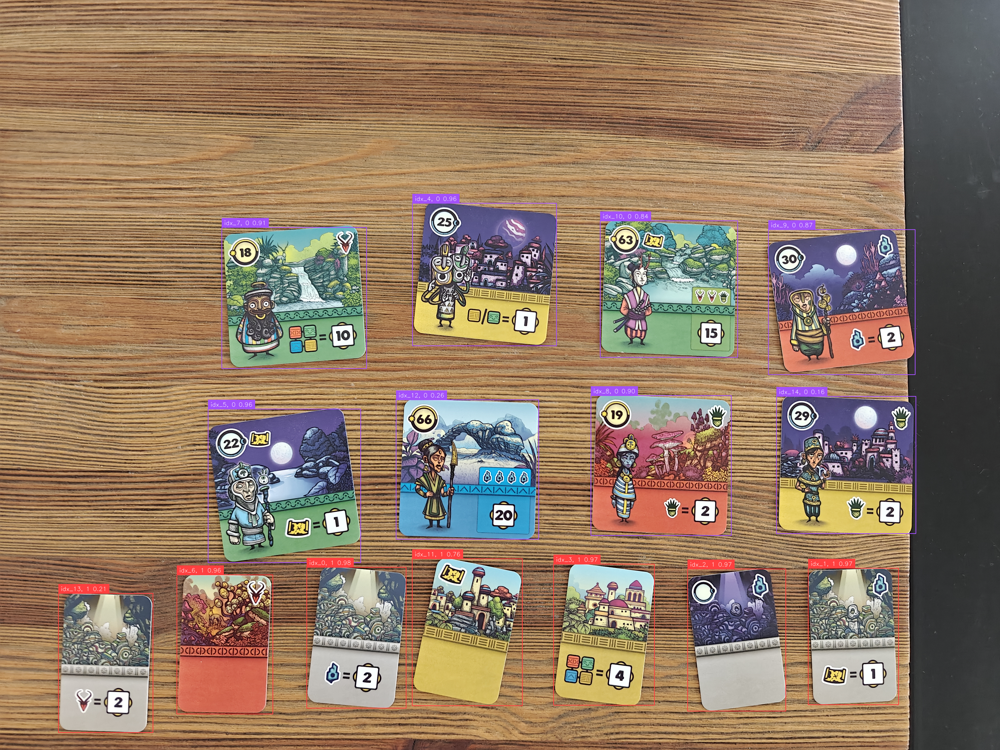

In [6]:
show_inference(image, detections)

In [7]:
explorations

[Card(id=18, stones=0, heads=1, plants=0, 
         color=green, night=False, hint=False, quest_needs={'stone': 0, 'head': 0, 'plant': 0}, 
         quest_trigger=all colors, quest_point=10),
 Card(id=25, stones=0, heads=0, plants=0, 
         color=yellow, night=True, hint=False, quest_needs={'stone': 0, 'head': 0, 'plant': 0}, 
         quest_trigger=yellow or green, quest_point=1),
 Card(id=63, stones=0, heads=0, plants=0, 
         color=green, night=False, hint=True, quest_needs={'stone': 0, 'head': 2, 'plant': 1}, 
         quest_trigger=nan, quest_point=15),
 Card(id=30, stones=1, heads=0, plants=0, 
         color=red, night=True, hint=False, quest_needs={'stone': 0, 'head': 0, 'plant': 0}, 
         quest_trigger=stone, quest_point=2),
 Card(id=22, stones=0, heads=0, plants=0, 
         color=green, night=True, hint=True, quest_needs={'stone': 0, 'head': 0, 'plant': 0}, 
         quest_trigger=hint, quest_point=1),
 Card(id=66, stones=0, heads=0, plants=0, 
         color=blue

In [88]:
sanctuary = image.crop(detections[1].xyxy[0])

In [ ]:
top_card: Image.Image = sanctuary.crop((0, 0, sanctuary.width, sanctuary.height // 3))
top_right_card: Image.Image = sanctuary.crop((sanctuary.width // 2, 0, sanctuary.width, sanctuary.height // 3))

In [ ]:
def canny_template_matching(image, template_path, canny_low=50, canny_high=150):
    """
    Applique Canny edge detection puis template matching

    Args:
        image_path: chemin de l'image source
        template_path: chemin du template
        canny_low: seuil bas pour Canny
        canny_high: seuil haut pour Canny
    """
    # Charger les images
    img = np.array(image.convert("RGB"))
    template = cv2.imread(template_path)

    if img is None or template is None:
        raise ValueError("Impossible de charger les images")

    # Convertir en niveaux de gris
    img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    template_gray = cv2.cvtColor(template, cv2.COLOR_BGR2GRAY)

    # Appliquer Canny edge detection
    img_edges = cv2.Canny(img_gray, canny_low, canny_high)
    template_edges = cv2.Canny(template_gray, canny_low, canny_high)

    # Template matching sur les contours
    result = cv2.matchTemplate(img_edges, template_edges, cv2.TM_CCOEFF_NORMED)

    # Trouver la meilleure correspondance
    min_val, max_val, min_loc, max_loc = cv2.minMaxLoc(result)

    # Dessiner le rectangle sur l'image originale
    h, w = template_edges.shape
    top_left = max_loc
    bottom_right = (top_left[0] + w, top_left[1] + h)

    img_result = img.copy()
    cv2.rectangle(img_result, top_left, bottom_right, (0, 255, 0), 2)

    # Afficher les résultats
    print("Image originale")
    display(Image.fromarray(img))
    print("Template originale")
    display(Image.fromarray(template))
    print("Contours Image")
    display(Image.fromarray(img_edges))
    print("Contours template")
    display(Image.fromarray(template_edges))
    print("Resultat")
    display(Image.fromarray(img_result))
    print(f"Score de correspondance: {max_val:.4f}")
    print(f"Position: {top_left}")

    return max_loc, max_val, img_result

In [ ]:
import matplotlib.pyplot as plt


def detect_and_display_logo(image, logo_path, num_matches=50):
    # Charger les images
    img_gray = np.array(image.convert("L"))
    logo = cv2.imread(logo_path)
    logo_gray = cv2.cvtColor(logo, cv2.COLOR_BGR2GRAY)

    # Détecteur ORB
    orb = cv2.ORB_create(5000)

    kp1, des1 = orb.detectAndCompute(logo_gray, None)
    kp2, des2 = orb.detectAndCompute(img_gray, None)

    print(f"Keypoints trouvés - Logo: {len(kp1)}, Image: {len(kp2)}")

    # Matcher
    bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)
    matches = bf.match(des1, des2)
    matches = sorted(matches, key=lambda x: x.distance)

    print(f"Total matches: {len(matches)}")
    print(f"Top 10 distances: {[m.distance for m in matches[:10]]}")

    # Dessiner les matches
    img_matches = cv2.drawMatches(
        logo,
        kp1,
        img_gray,
        kp2,
        matches[:num_matches],
        None,
        flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS,
    )

    # Afficher
    plt.figure(figsize=(20, 10))
    plt.imshow(cv2.cvtColor(img_matches, cv2.COLOR_BGR2RGB))
    plt.title(f"Top {num_matches} matches")
    plt.axis("off")
    plt.tight_layout()
    plt.show()

    return matches

Image originale


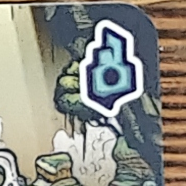

Template originale


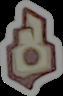

Contours Image


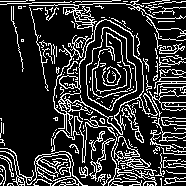

Contours template


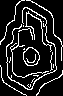

Resultat


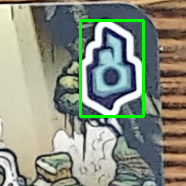

Score de correspondance: 0.4960
Position: (80, 20)


In [ ]:
# Exemple d'utilisation
template_path = "/Users/mathisnicoli/Desktop/Projets/faraway/faraway/dev/assets/stone.png"
position, score, result = canny_template_matching(top_right_card, template_path)

Keypoints trouvés - Logo: 0, Image: 836
Total matches: 0
Top 10 distances: []


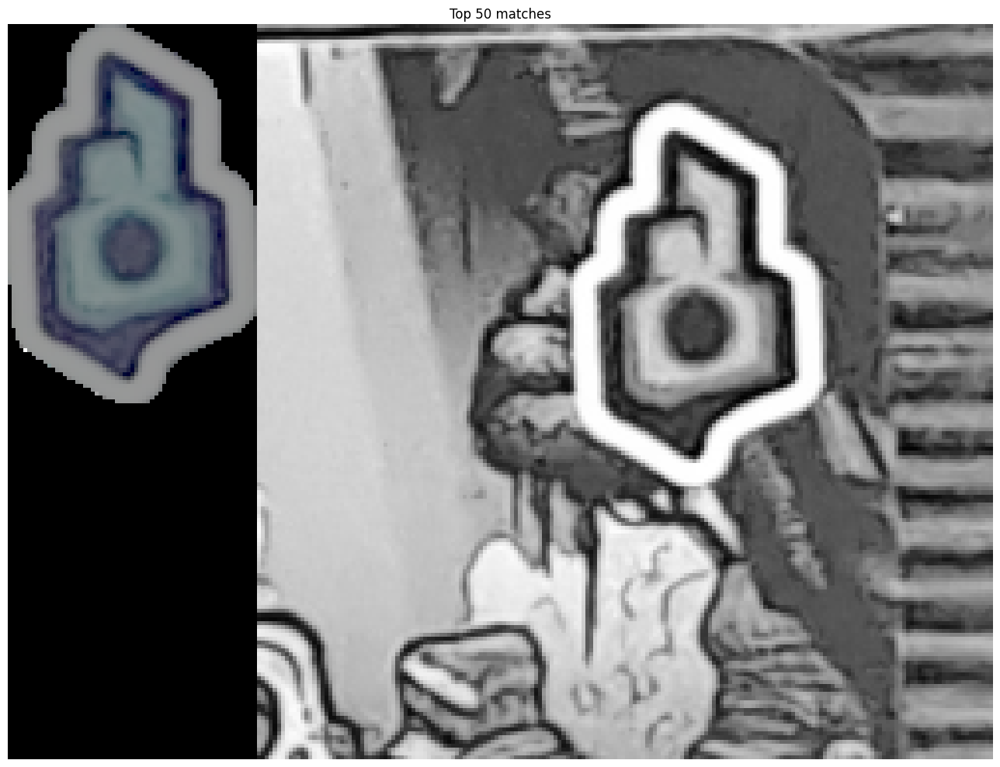

In [93]:
matches = detect_and_display_logo(top_right_card, template_path)